# Apr 28th, 2022 (plot ca node discont. + grey bg motion)

**Motivation**:
<br>

In [1]:
# HIDE CODE


import os
import sys
from pprint import pprint
from copy import deepcopy as dc
from os.path import join as pjoin
from numpy.ma import masked_where as mwh
from IPython.display import display, IFrame, HTML

# tmp & extras dir
git_dir = pjoin(os.environ['HOME'], 'Dropbox/git')
tmp_dir = pjoin(git_dir, 'jb-Ca-fMRI/tmp')
_fig_dir = pjoin(git_dir, 'jb-Ca-fMRI/figs')
extras_dir = pjoin(git_dir, 'jb-Ca-fMRI/_extras')
lfr_dir = 'Documents/workspaces/lfr/binary_overlapping'
lfr_dir = pjoin(os.environ['HOME'], lfr_dir)

# GitHub
sys.path.insert(0, pjoin(git_dir, '_Ca-fMRI'))
from register.atlas import make_tree_graph
from register.parcellation import Parcellation
from analysis.hierarchical import Hierarchical
from analysis.fourier import *
from analysis.bootstrap import *
from analysis.svinet import *
from analysis.group import *
from analysis.lfr import *
from utils.render import *
from utils.plotting import *
from model.mouse import Mice
from model.configuration import Config

# set style & no interpolalation
matplotlib.rcParams['image.interpolation'] = 'none'
sns.set_style('whitegrid')
%matplotlib inline

# warnings
warnings.filterwarnings('ignore', category=DeprecationWarning)

In [2]:
mice = Mice(64)

[PROGRESS] 'config.json' saved at
/home/hadi/Documents/Ca-fMRI/processed/norm-global_parcel-columnar_n-64*3

ROI lookup not found, time to run organize_func() . . .

combine metadata not found, time to run cat_data() . . .

In [ ]:
mice.parcel.fit_parcel()

Parcellation not found, initiating fit

[PROGRESS] fit columnar: initiated

Intel(R) oneAPI Data Analytics Library solvers for sklearn enabled: https://intelpython.github.io/daal4py/sklearn.html


[PROGRESS] kmeans fit: done

[PROGRESS] save 2D 10um: done

In [2]:
def _plot_gs_ca_with_censor_mask():
    fig, axes = create_figure(3, 1, (13, 10), 'all', tight_layout=False)
        
    for ax in axes.flat:
        for seg in segments:
            ax.axvspan(min(seg), max(seg), color='dimgrey', alpha=0.3, lw=0,  zorder=0)
        for i in discont_ids:
            ax.axvline(i + 0.5, color='r', ls='--', lw=1.0)

    gs = bn.nanmean(x, 0)
    axes[0].plot(gs, color='k', lw=1.2)
    axtw = axes[0].twinx()
    axtw.set_ylabel('GS', rotation=-90, labelpad=20, fontsize=14)
    axtw.set_yticks([])

    axes[1].plot(x.T, lw=0.8)
    axtw = axes[1].twinx()
    axtw.set_ylabel('all nodes', rotation=-90, labelpad=20, fontsize=14)
    axtw.set_yticks([])

    x2p = x[np.arange(0, len(x), 20)]
    axes[2].plot(x2p.T, lw=1.0)
    axtw = axes[2].twinx()
    axtw.set_ylabel('every 20 nodes', rotation=-90, labelpad=20, fontsize=14)
    axtw.set_yticks([])

    sup = fig.suptitle(f"{key} ({percent_removed:0.1f} % removed)", fontsize=17, y=0.93)
    plt.close()
    
    return fig, sup

## Fig dir

In [3]:
set_style()
fig_kws = {
    'dpi': 200,
    'transparent': False,
    'bbox_inches': 'tight',
}
fig_dir = pjoin(_fig_dir, 'quality_control')
os.makedirs(fig_dir, exist_ok=True)
fig_dir

'/home/hadi/Dropbox/git/jb-Ca-fMRI/figs/quality_control'

In [4]:
save_dir = pjoin(fig_dir, 'GS_CA2')
os.makedirs(save_dir, exist_ok=True)
save_dir

'/home/hadi/Dropbox/git/jb-Ca-fMRI/figs/quality_control/GS_CA2'

## Mice

In [5]:
mice = Mice(Config(128, 3, exclude=0))
mice.setup_func_data('all', exclude=False, runs_only=True)

## Censor masks

In [6]:
f = pjoin(mice.cfg.base_dir, 'meta_info')
df = pd.read_pickle(pjoin(f, 'temporal_mask.df'))

## Discontinuity times

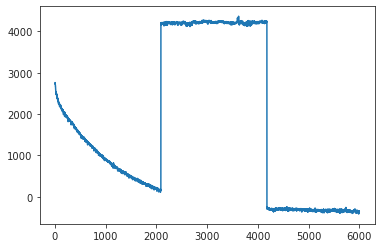

In [7]:
key = mice.get_key(2, 1, 3)
x = mice.ca[key][:]
gs = bn.nanmean(x, 0)

plt.plot(gs);

In [8]:
discont_ids = np.argsort(np.abs(np.diff(gs)))[-2:]
discont_ids

array([2088, 4178])

In [9]:
for i in discont_ids:
    print(f"i = {i},  gs[i] = {gs[i]}, gs[i + 1] = {gs[i + 1]}")

i = 2088,  gs = 155.1355308430821, gs = 4213.300392368619

i = 4178,  gs = 4227.700446334898, gs = -292.9524600907258

## Generate plots

In [10]:
%%time

for key, func in mice.ca.items():
    x = func[:]
    if x is None:
        continue
        
    tmask = df.loc[
        df['key'] == key,
        'temporal_mask',
    ].values
    tmask_up = np.repeat(tmask, 10)
    censored = np.where(tmask_up == 0)[0]
    looper = itertools.groupby(
        enumerate(censored),
        lambda t: t[0] - t[1],
    )
    segments = []
    for k, g in looper:
        s = map(operator.itemgetter(1), g)
        segments.append(list(s))
    percent_removed = (1 - tmask.sum() / len(tmask)) * 100
    if len(tmask):
        assert abs(sum([len(a) for a in segments]) / (len(tmask) * 10) * 100 - percent_removed) < 1e-8
    
    fig, sup = _plot_gs_ca_with_censor_mask()
    fig.savefig(pjoin(save_dir, f"gs-ca2_{key}.png"), **fig_kws)

CPU times: user 8min 18s, sys: 10.8 s, total: 8min 29s
Wall time: 8min 29s


In [13]:
discont_ids

array([2088, 4178])

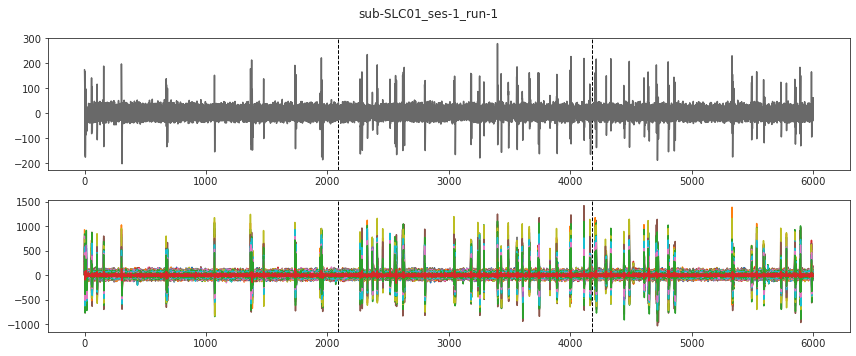

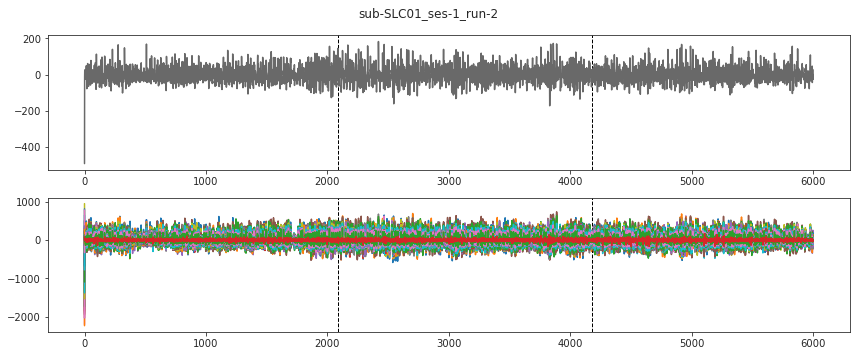

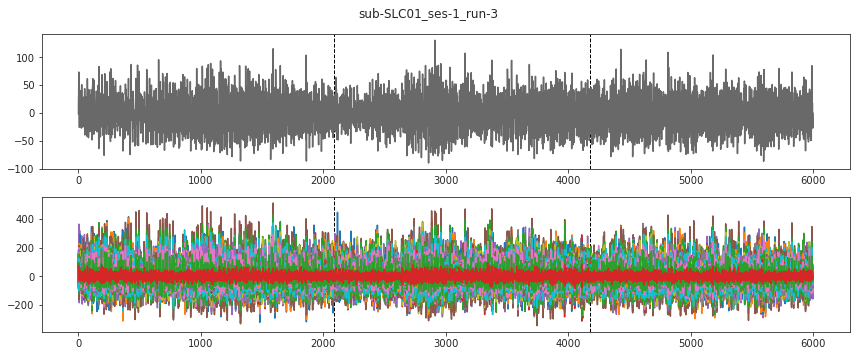

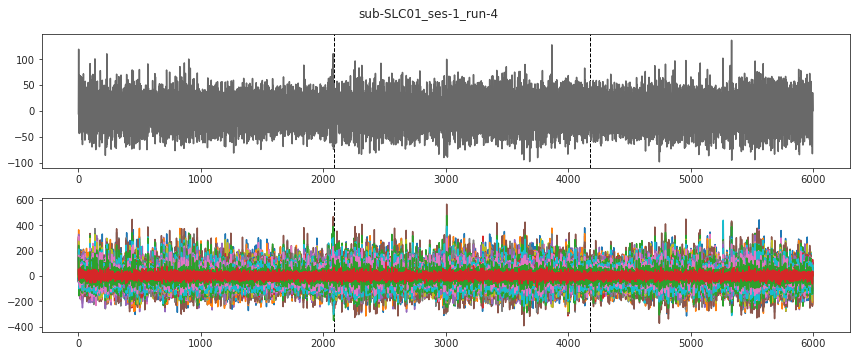

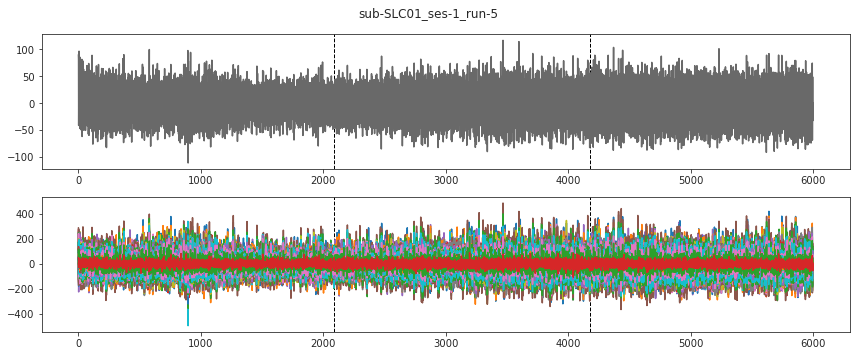

...

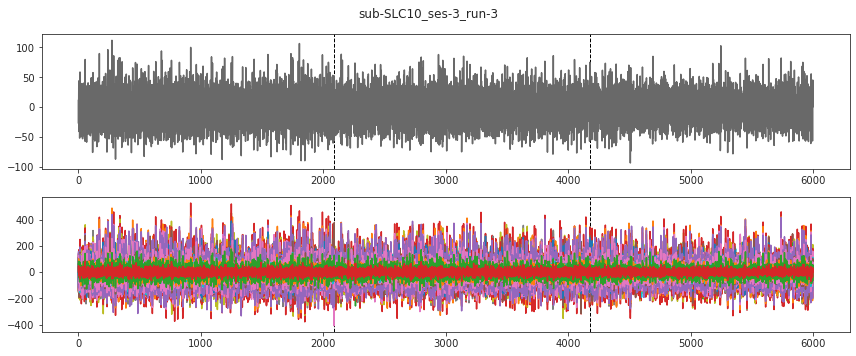

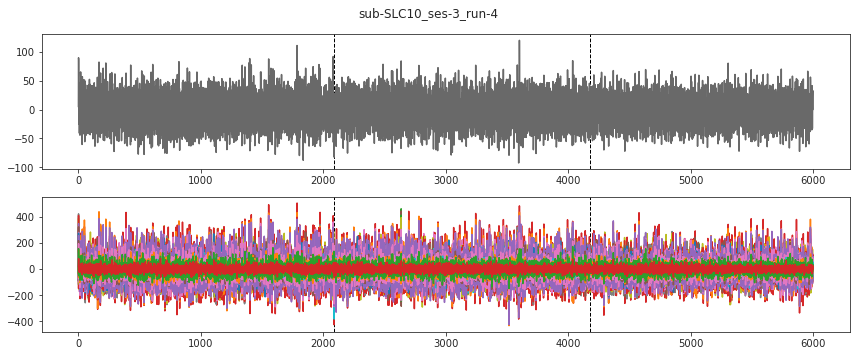

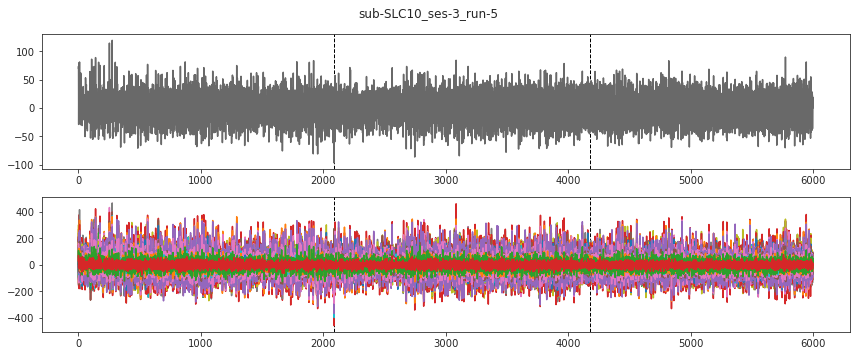

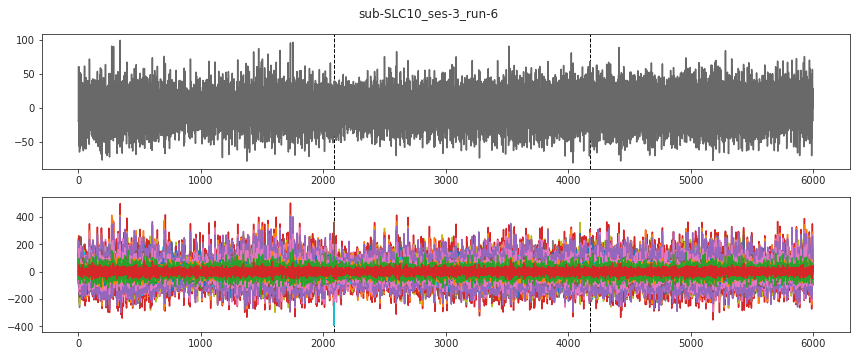

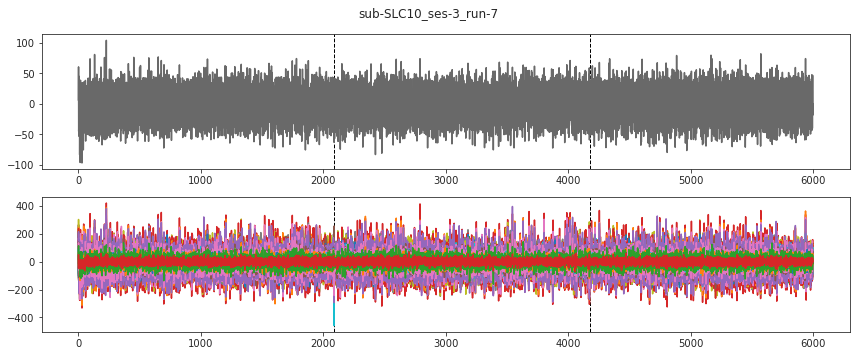

CPU times: user 4min 55s, sys: 2.72 s, total: 4min 57s
Wall time: 4min 57s


In [25]:
%%time

for key, func in mice.ca.items():
    x = func[:]
    if x is None:
        continue
    
    fig, axes = create_figure(2, 1, (12, 5))
    for ax in axes.flat:
        for i in discont_ids:
            ax.axvline(i + 0.5, color='k', ls='--', lw=1.0)
    
    gs = bn.nanmean(x, 0)
    y = np.zeros(len(gs))
    y[:-1] = np.diff(gs)
    axes[0].plot(y.T, color='dimgrey')
    
    y = np.zeros_like(x)
    y[:, :-1] = np.diff(x, axis=1)
    axes[1].plot(y.T)
    
    fig.suptitle(key)
    plt.show()

In [157]:
for key, func in mice.ca.items():
    if key != mice.get_key(10, 1, 3):
        continue
    
    x = func[:]
    if x is None:
        continue
        
    good = np.isnan(x).sum(1) == 0
    x = x[good]

In [158]:
delta = 10
a = x[:, discont_ids[0] - delta: discont_ids[0] + delta]
b = np.zeros_like(a)
b[:, :-1] = np.diff(a, axis=-1)

a.shape, b.shape

((151, 20), (151, 20))

In [159]:
mu = np.nanstd(b, axis=1)#, keepdims=True)
sd = np.nanstd(b, axis=1)#, keepdims=True)
nb_stds = np.abs(b.max(1) - mu) / sd

<AxesSubplot:ylabel='Count'>

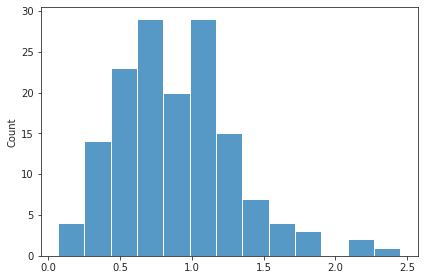

In [160]:
fig, ax = create_figure()
sns.histplot(nb_stds, ax=ax)

In [169]:
sus = np.where(nb_stds > 2)[0]
sus

array([ 91, 107, 146])

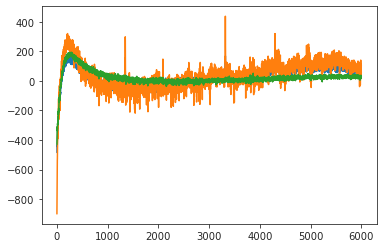

In [170]:
plt.plot(x[sus].T);

In [134]:
outlier = dict(zip(*np.where((b - mu) >= b.max(1))))

ValueError: operands could not be broadcast together with shapes (146,20) (146,) 

<matplotlib.lines.Line2D object at 0x7f5130bb3040>

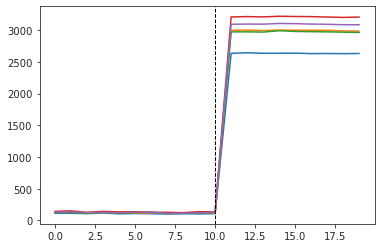

In [115]:
i = 18
plt.plot(a[range(5 * i, 5 * (i + 1))].T)
plt.axvline(delta, color='k', ls='--', lw=1.0)

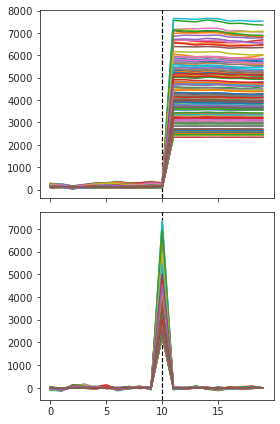

In [117]:
fig, axes = create_figure(2, 1, (4, 6), 'all')
axes[0].axvline(delta, color='k', ls='--', lw=1.2)
axes[1].axvline(delta, color='k', ls='--', lw=1.2)
axes[0].plot(a.T)
axes[1].plot(b.T)

plt.show()

In [128]:
mu = np.nanstd(b, axis=1, keepdims=True)
sd = np.nanstd(b, axis=1, keepdims=True)

<AxesSubplot:ylabel='Count'>

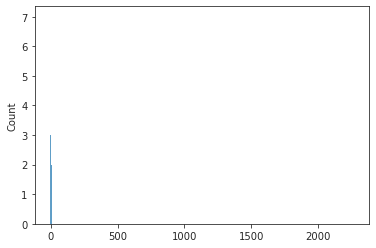

In [122]:
sns.histplot(b[4])